# Area and density based count estimation

In [1]:

import skimage

import matplotlib.pyplot as plt

import sys

sys.path += [".."]  # NOTE find shared modules
from util.preprocess import *
from util.plot import *
from util.onnx import *

import pandas as pd


def norm(x):
  return (x - x.min()) / (x.max() - x.min())

In [2]:

dataset = 'third'

data = pd.read_csv(f'../data/{dataset}/data.csv', sep='\s+')
load_image = lambda i: skimage.io.imread(f"../data/{dataset}/{i}.jpg").astype(np.float32) / 255

data.head()

,img,flask,mag,vol,count
0,1,0,20,150,47400000.0
1,2,0,20,150,47400000.0
2,3,0,20,150,47400000.0
3,4,1,20,150,31000000.0
4,5,A,20,150,106000000.0


In [3]:
stens = get_onnx("../data/phaseimaging-combo-v3.onnx")

2023-12-03 14:03:11.700114656 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10545, index: 6, mask: {7, 31, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-12-03 14:03:11.699850994 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10539, index: 0, mask: {1, 25, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-12-03 14:03:11.699824946 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10543, index: 4, mask: {5, 29, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-12-03 14:03:11.699826867 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10540, index: 1, mask: {2, 26, }, error code: 22 error msg: Invalid argument. Speci

t.
2023-12-03 14:03:11.736150225 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10559, index: 20, mask: {21, 45, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-12-03 14:03:11.721016170 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 10555, index: 16, mask: {17, 41, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-12-03 14:03:11.882432882 [E:onnxruntime:Default, provider_bridge_ort.cc:1480 TryGetProviderInfo_CUDA] /onnxruntime_src/onnxruntime/core/session/provider_bridge_ort.cc:1193 onnxruntime::Provider& onnxruntime::ProviderLibrary::Get() [ONNXRuntimeError] : 1 : FAIL : Failed to load library libonnxruntime_providers_cuda.so with error: libcublasLt.so.11: cannot open shared object file: No such file or directory

2023-12-03 14:03:11.882472546 [W:onnxruntime:De

,img,flask,mag,vol,count,area,dens
0,1,0,20,150,47400000.0,2029230.0,23.358614
1,2,0,20,150,47400000.0,1715015.0,27.638242
2,3,0,20,150,47400000.0,2566337.0,18.469905
3,4,1,20,150,31000000.0,1958648.0,15.827244
4,5,A,20,150,106000000.0,3030237.0,34.980762


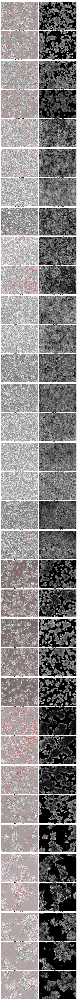

In [4]:

shape = skimage.io.imread(f"../data/{dataset}/{data.iloc[0]['img']}.jpg").shape[:2]
fig, axs = mk_fig(2,34, shape=shape, flat=False, scale=0.25)

for I,(i,row) in enumerate(data.iterrows()):
  X = load_image(row['img'])

  input = np.expand_dims(np.transpose(X[..., [2, 1]], (2, 0, 1)), axis=0)  # B and G chans

  pred = stens(input)
  mask = (pred[0, 0] > (thresh := 0.01)).reshape(X.shape[:2])

  area = mask.sum() 
  count = row['count']
  dens = count / area

  data.loc[i, 'area'] = area
  data.loc[i, 'dens'] = dens

  # mark the boundaries

  plot_image(
    skimage.segmentation.mark_boundaries(
      skimage.color.label2rgb(1 - mask, X, bg_color=None, alpha=0.05),
      mask, color=(1, 0, 0), mode='thick'),
    title=f"Mask: {row['img']} ({row['flask']}, {row['mag']}x)",
    ax=axs[I, 0],
  )

  plot_image(
    pred[0, 0], title=f"B-G Phase: {row['img']} ({row['flask']}, {row['mag']}x)", ax=axs[I, 1]
  )


data.head()

Relative standard deviation of the density is 0.22


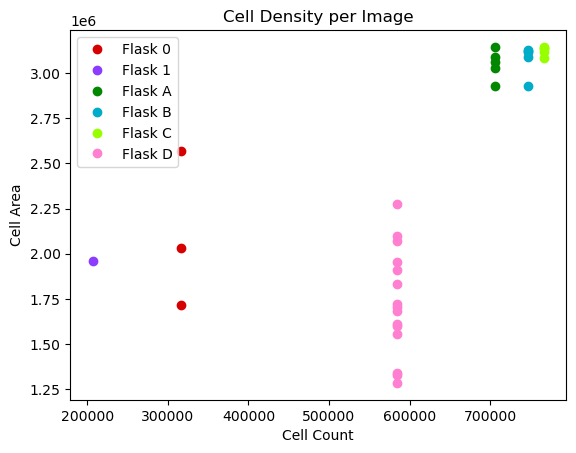

In [5]:

def flask_distribution(flasks=data['flask'].unique()):
  flask2color = dict(zip(flasks, colors))
  cs = list(data['flask'].map(flask2color).values)

  fig, ax = plt.subplots()
  ax.set_title('Cell Density per Image')
  ax.set_xlabel('Cell Count')
  ax.set_ylabel('Cell Area')

  _data = data.query(f'flask in {list(flasks)}')

  _allready_labeled__flasks = set()
  for i in range(len(_data)):
    count_norm = _data.iloc[i]['count'] / _data.iloc[i]['vol']
    ax.plot(count_norm, _data.iloc[i]['area'], 'o', c=cs[i])
    if _data.iloc[i]['flask'] not in _allready_labeled__flasks:
      ax.plot([], [], 'o', c=cs[i], label=f"Flask {_data.iloc[i]['flask']}")
      _allready_labeled__flasks.add(_data.iloc[i]['flask'])

  ax.legend()

  rel_std =  _data['dens'].std() / _data['dens'].mean()

  print(f"Relative standard deviation of the density is {rel_std:.2f}")

flask_distribution()

In [6]:

relstds = []
for flask in data['flask'].unique():
  dens = data.query(f'flask == "{flask}"')['dens'].mean()
  stdev = data.query(f'flask == "{flask}"')['dens'].std()
  relstd = stdev / dens 
  relstds.append(relstd)
  print(f"Flask {flask} has a mean density of {dens:.2f}±{stdev:.2f} (±{relstd*100:.2f}%)")

print(f"Mean relative standard deviation of the fluctuation is {np.mean(relstds):.2f} (±{np.std(relstds):.2f})")

Flask 0 has a mean density of 23.16±4.59 (±19.81%)
Flask 1 has a mean density of 15.83±nan (±nan%)
Flask A has a mean density of 34.79±0.93 (±2.66%)
Flask B has a mean density of 36.42±1.04 (±2.86%)
Flask C has a mean density of 36.83±0.28 (±0.77%)
Flask D has a mean density of 26.01±4.55 (±17.50%)
Mean relative standard deviation of the fluctuation is nan (±nan)


Text(0.5, 0.98, '')

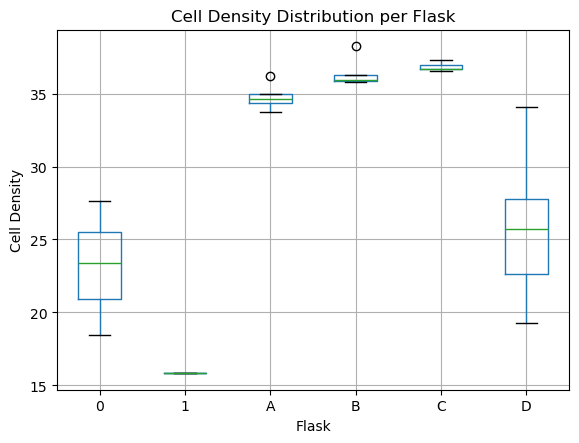

In [7]:

fig, ax = plt.subplots()
data.boxplot(column='dens', by='flask', ax=ax)
ax.set_title('Cell Density Distribution per Flask')
ax.set_xlabel('Flask')
ax.set_ylabel('Cell Density')
fig.suptitle("")

Density of flask D, objective 10x: 22.72±3.03 (±0.13%)
Density of flask D, objective 20x: 25.70±4.41 (±0.17%)
Density of flask D, objective 40x: 29.60±3.74 (±0.13%)


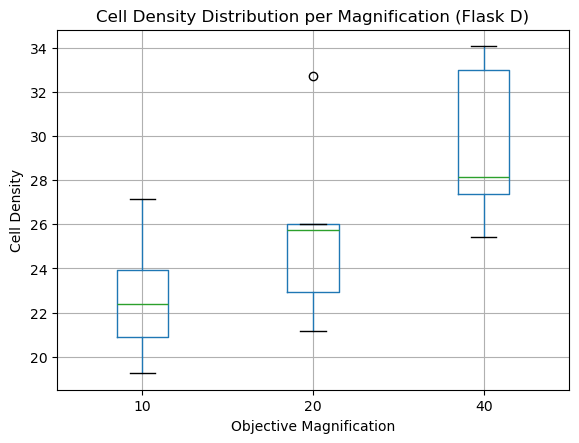

In [8]:

_data = data.query('flask == "D"')

# now plot only the images from flask D, but catergorical by the magnification
fig, ax = plt.subplots(1,1)

_data.boxplot(column='dens', by='mag', ax=ax)
ax.set_title(f"Cell Density Distribution per Magnification (Flask D)")
ax.set_xlabel('Objective Magnification')
ax.set_ylabel('Cell Density')
fig.suptitle("")

_data.groupby('mag')['dens'].apply(lambda x: (
  relstd := x.std() / x.mean(),
  print(f"Density of flask D, objective {x.name}x: {x.mean():.2f}±{x.std():.2f} (±{relstd:.2f}%)")
));

## Observations
- error for all magnifications is roughly the same
- lower magnification detects more unproportionally more background 
  - the reason seems to be that the phase invariances don't hold 